# Import Libraries

In [102]:
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt

from scipy.spatial import minkowski_distance
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans as KMeans_1

from yellowbrick.cluster import KElbowVisualizer

import itertools as it

from utitilies.data_visualizers import view_clusters_3d
from algorithm.kmeans import KMeans as KMeans_2, load_ecomm_data, load_ext_data

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load and visualize data

In [103]:
df = pd.read_csv('./data/E-commerce.csv')
df

,ID,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration,profile_information
0,2085,643,142,300.000000,228.432503,132,411
1,742,527,95,743.832508,60.882831,86,184
2,750,367,49,305.668886,72.961801,334,329
3,1224,466,30,291.191193,101.903170,131,148
4,2210,715,169,703.136878,506.416735,114,160
...,...,...,...,...,...,...,...
2495,269,231,165,3328.628199,148.313702,157,314
2496,399,241,26,1985.954206,5.129457,220,206
2497,945,561,85,936.915959,146.637412,96,198
2498,771,347,61,404.905296,119.284162,194,117


In [104]:
# drop ID and profile information column column
df.drop(columns=['ID', 'profile_information'], inplace=True)
df

,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration
0,643,142,300.000000,228.432503,132
1,527,95,743.832508,60.882831,86
2,367,49,305.668886,72.961801,334
3,466,30,291.191193,101.903170,131
4,715,169,703.136878,506.416735,114
...,...,...,...,...,...
2495,231,165,3328.628199,148.313702,157
2496,241,26,1985.954206,5.129457,220
2497,561,85,936.915959,146.637412,96
2498,347,61,404.905296,119.284162,194


# Preprocessing data

* ### will be later visualized in 3d so keep only 3 variables/features e.g. n_clicks, n_visits, amount_spent
* ### normalize data

##### generate permutations and then visualize

In [105]:
X = df

# find permutations of features that form clusters
permutations = list(it.permutations(df.columns, 3))
permutations

[('n_clicks', 'n_visits', 'amount_spent'),
 ('n_clicks', 'n_visits', 'amount_discount'),
 ('n_clicks', 'n_visits', 'days_since_registration'),
 ('n_clicks', 'amount_spent', 'n_visits'),
 ('n_clicks', 'amount_spent', 'amount_discount'),
 ('n_clicks', 'amount_spent', 'days_since_registration'),
 ('n_clicks', 'amount_discount', 'n_visits'),
 ('n_clicks', 'amount_discount', 'amount_spent'),
 ('n_clicks', 'amount_discount', 'days_since_registration'),
 ('n_clicks', 'days_since_registration', 'n_visits'),
 ('n_clicks', 'days_since_registration', 'amount_spent'),
 ('n_clicks', 'days_since_registration', 'amount_discount'),
 ('n_visits', 'n_clicks', 'amount_spent'),
 ('n_visits', 'n_clicks', 'amount_discount'),
 ('n_visits', 'n_clicks', 'days_since_registration'),
 ('n_visits', 'amount_spent', 'n_clicks'),
 ('n_visits', 'amount_spent', 'amount_discount'),
 ('n_visits', 'amount_spent', 'days_since_registration'),
 ('n_visits', 'amount_discount', 'n_clicks'),
 ('n_visits', 'amount_discount', 'am

# Exploratory data analysis

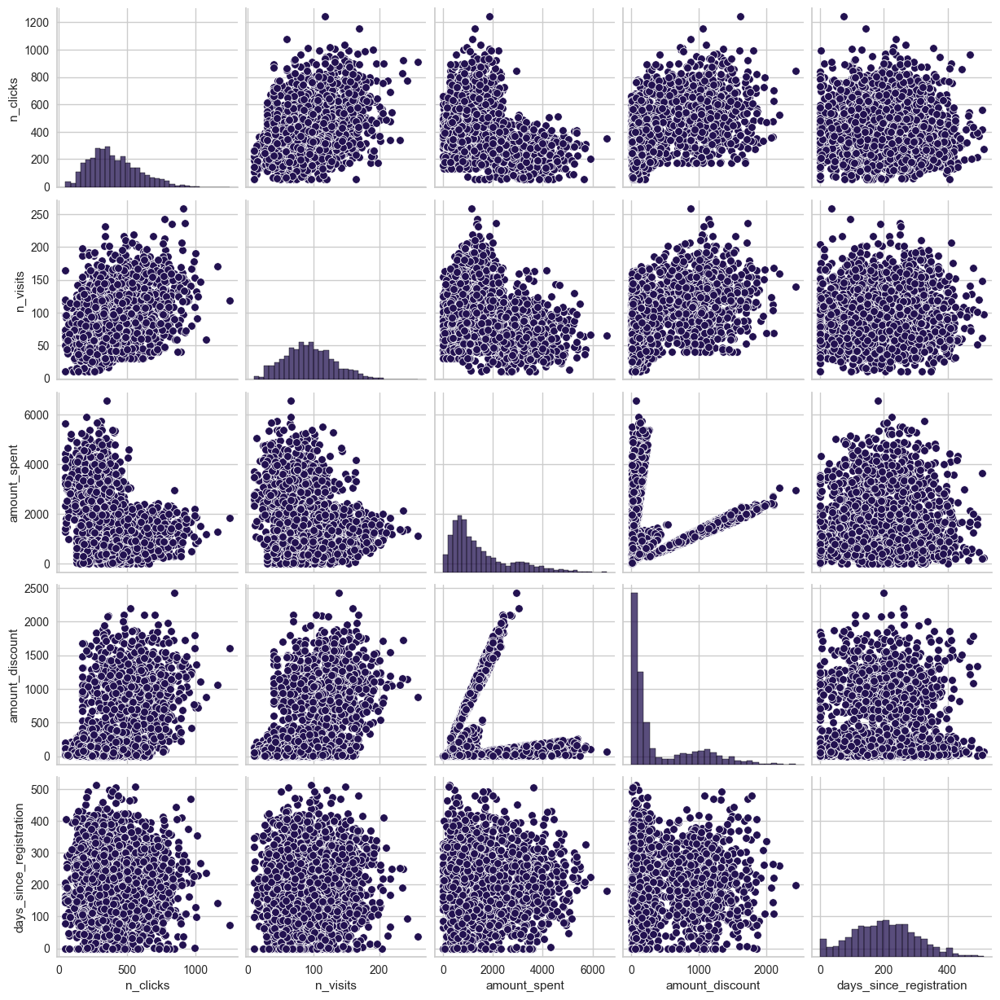

In [106]:
sb.set_palette('magma')
sb.pairplot(X)
plt.show()

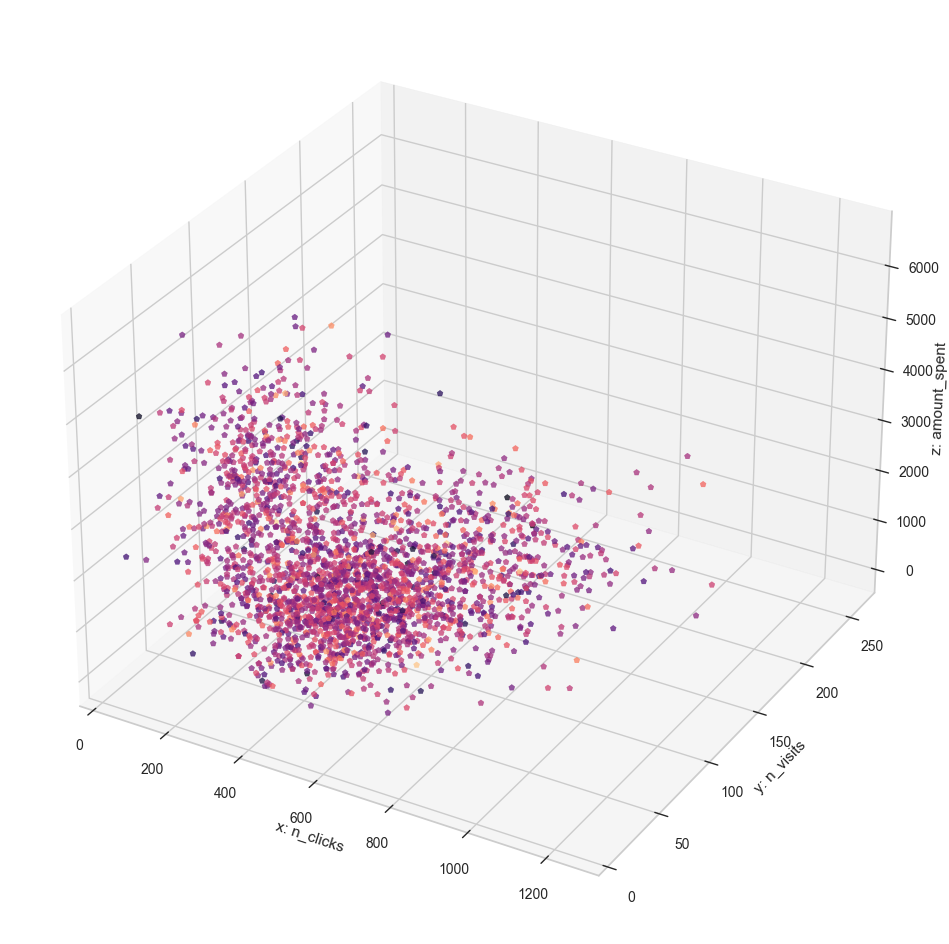

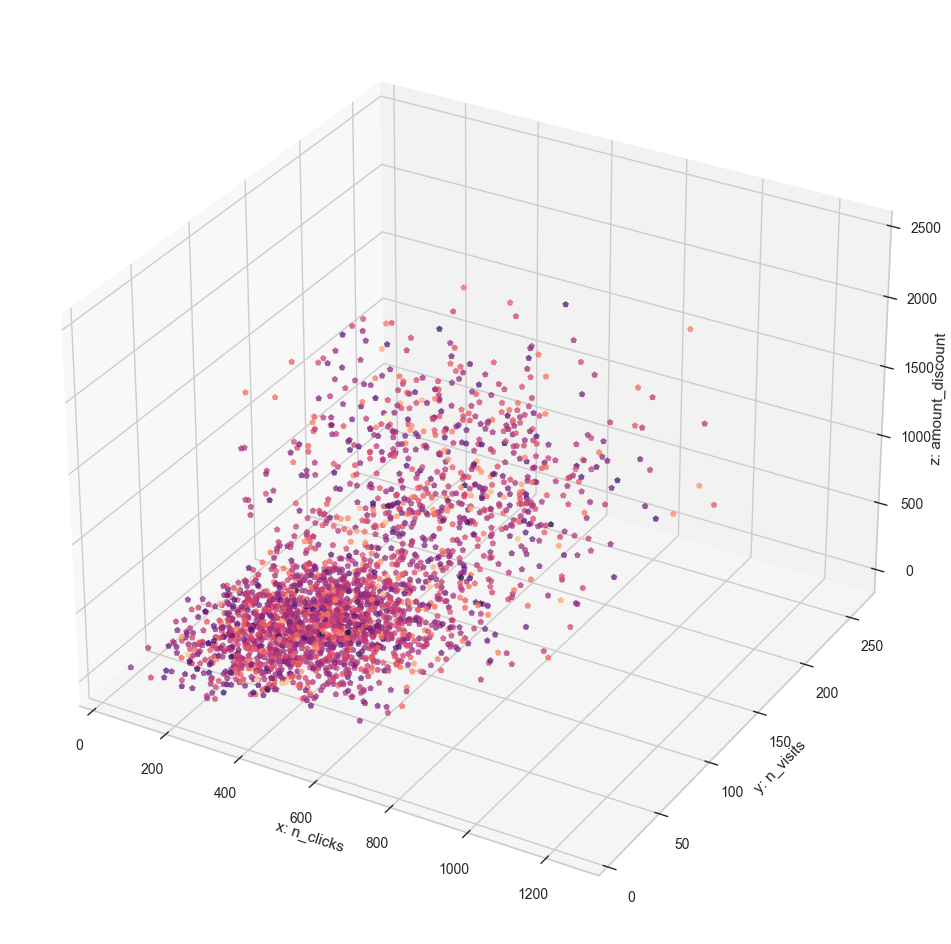

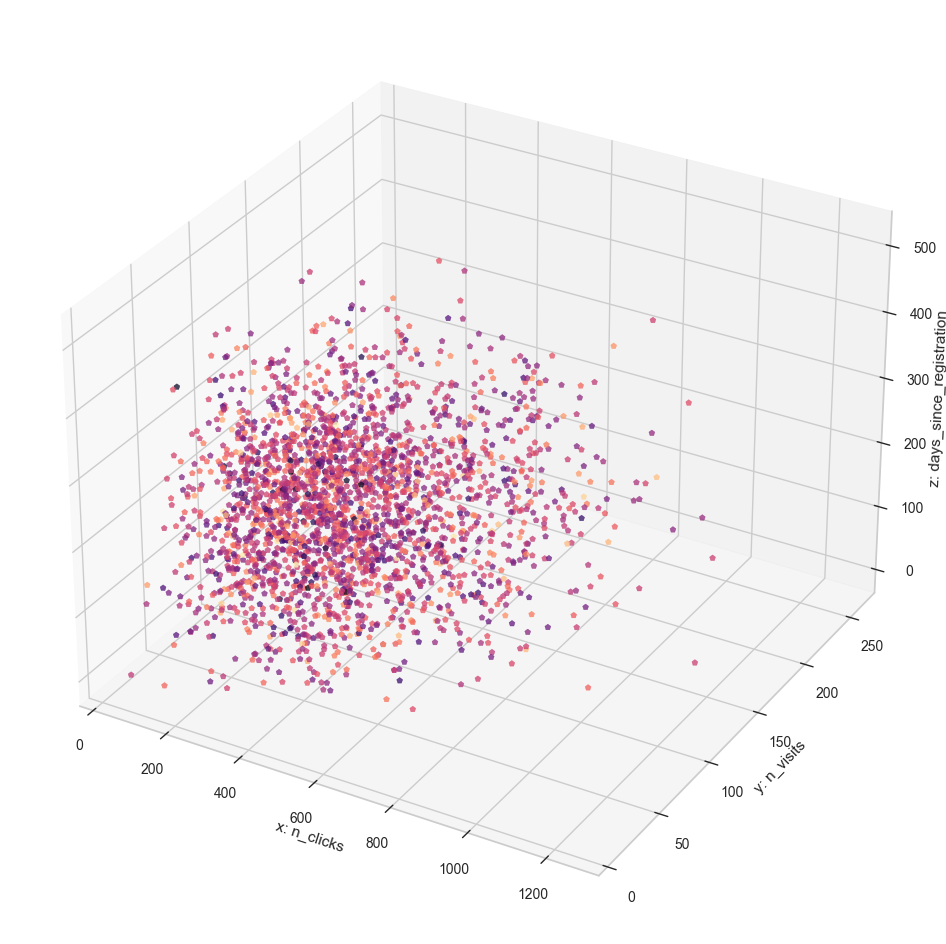

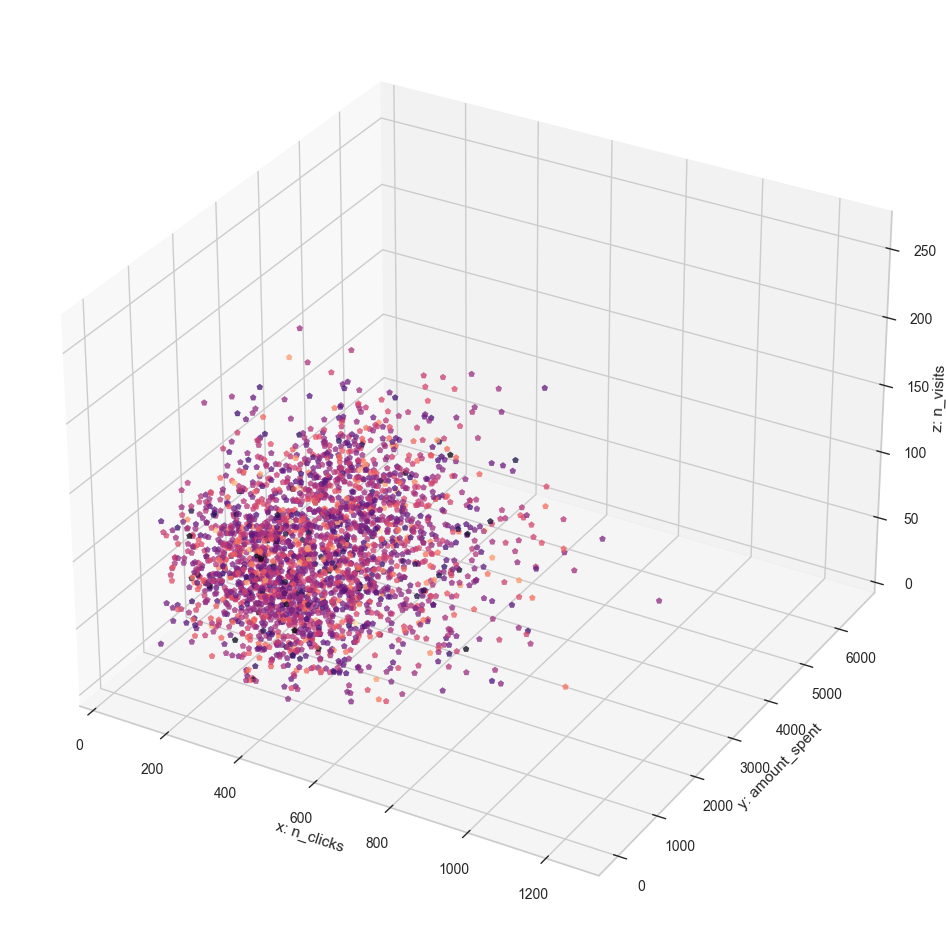

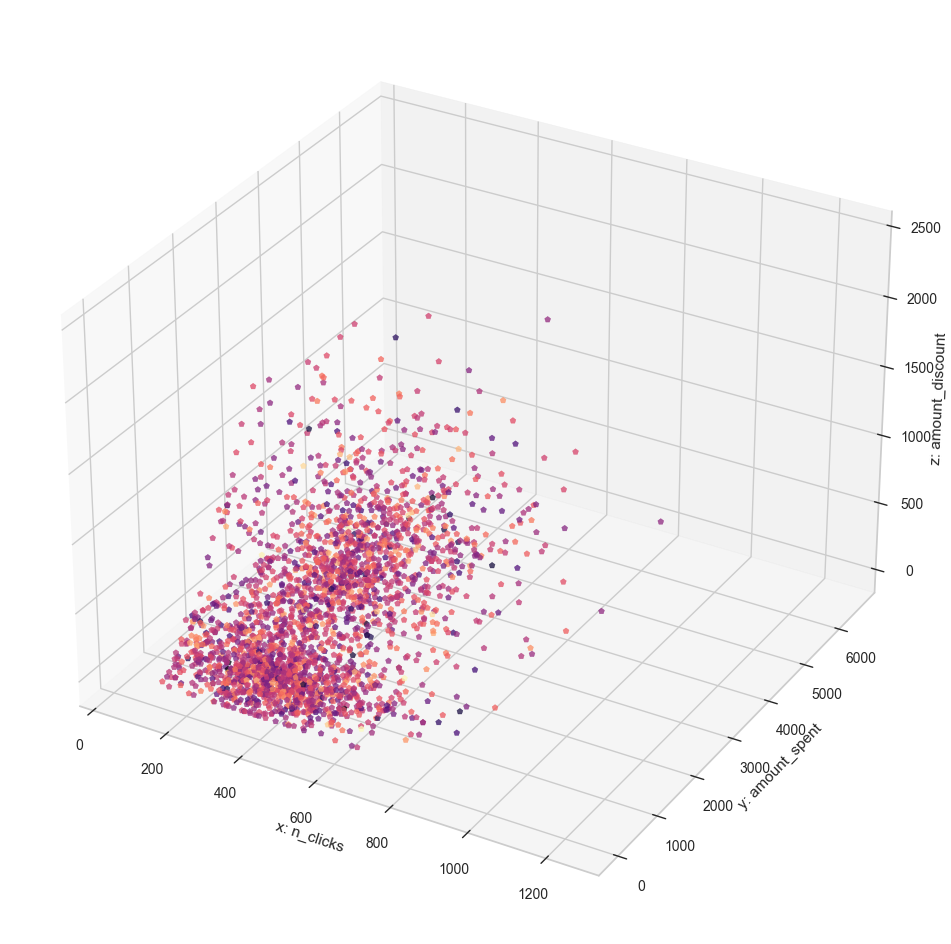

...

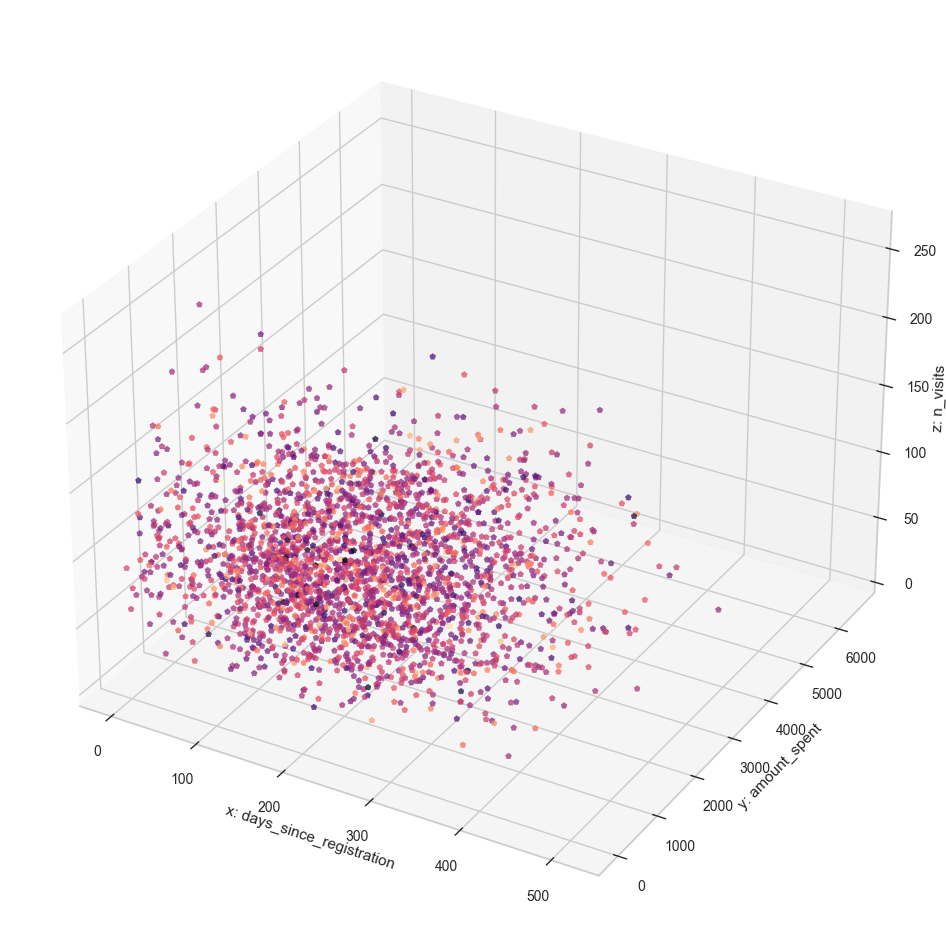

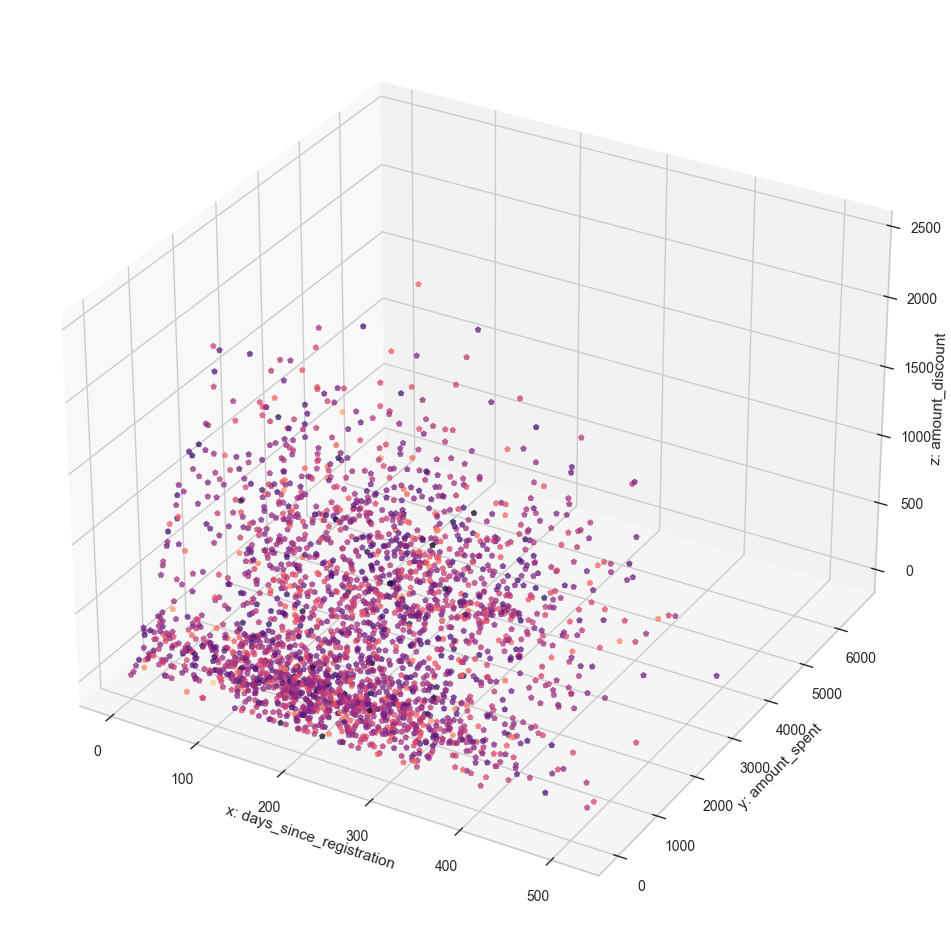

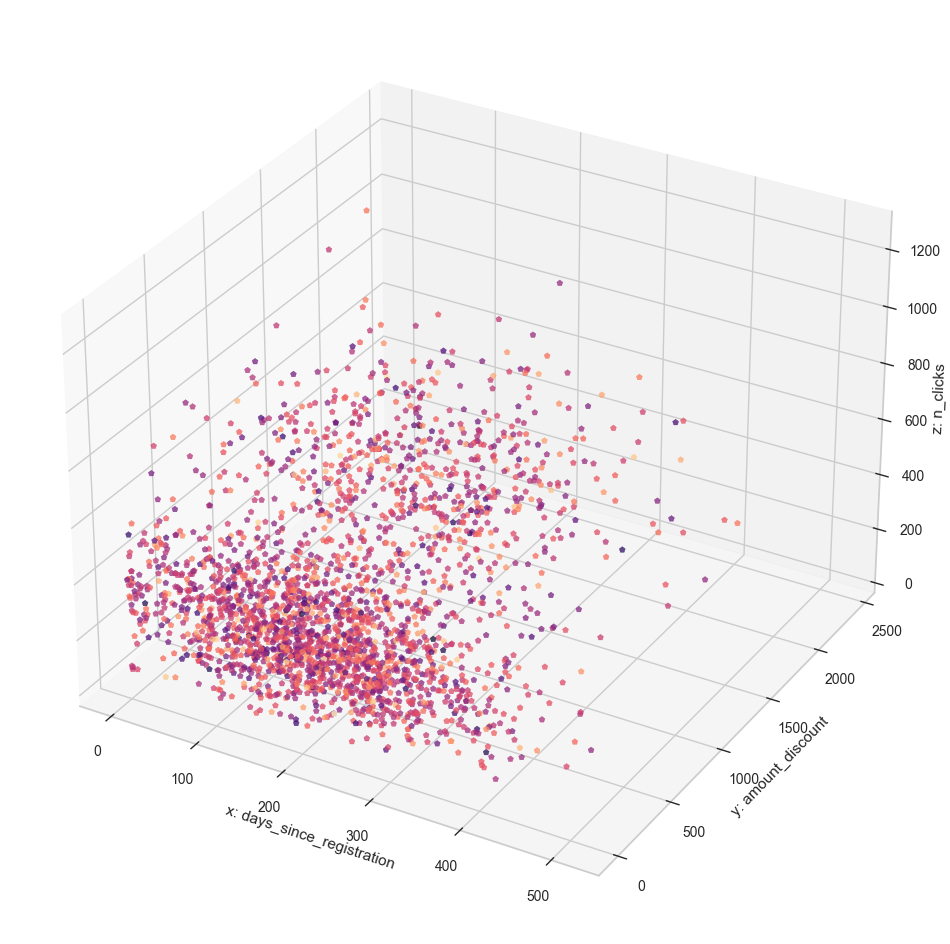

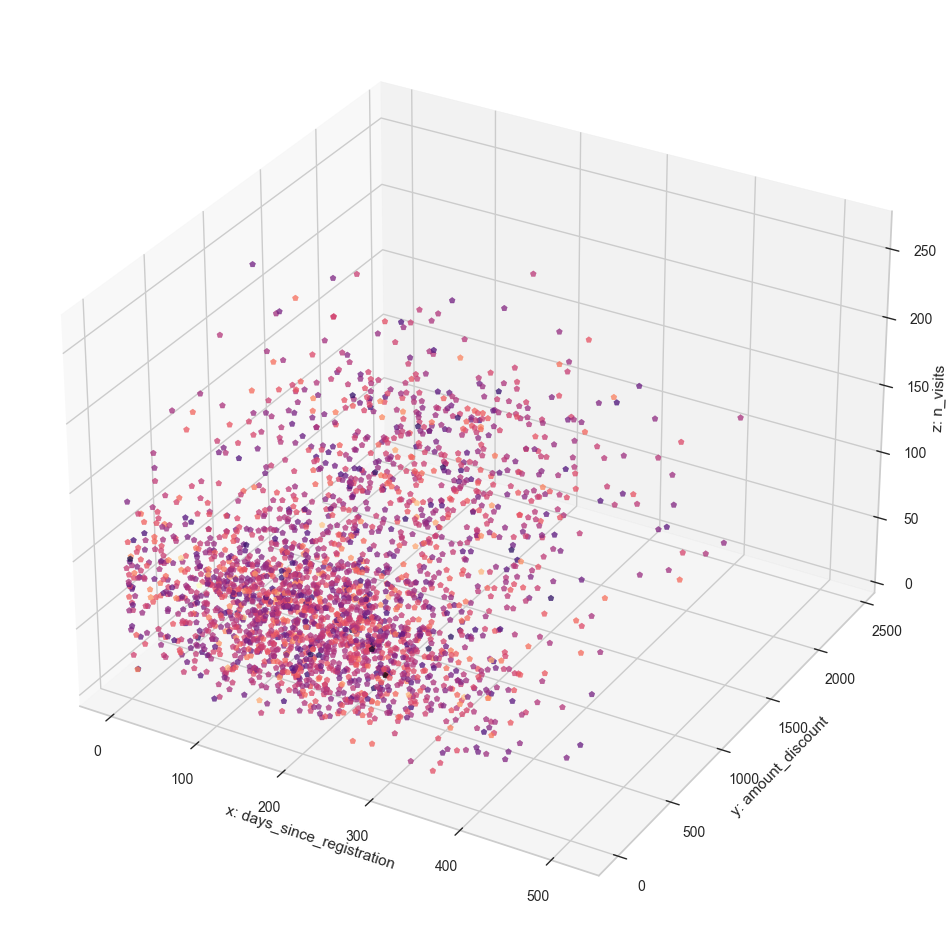

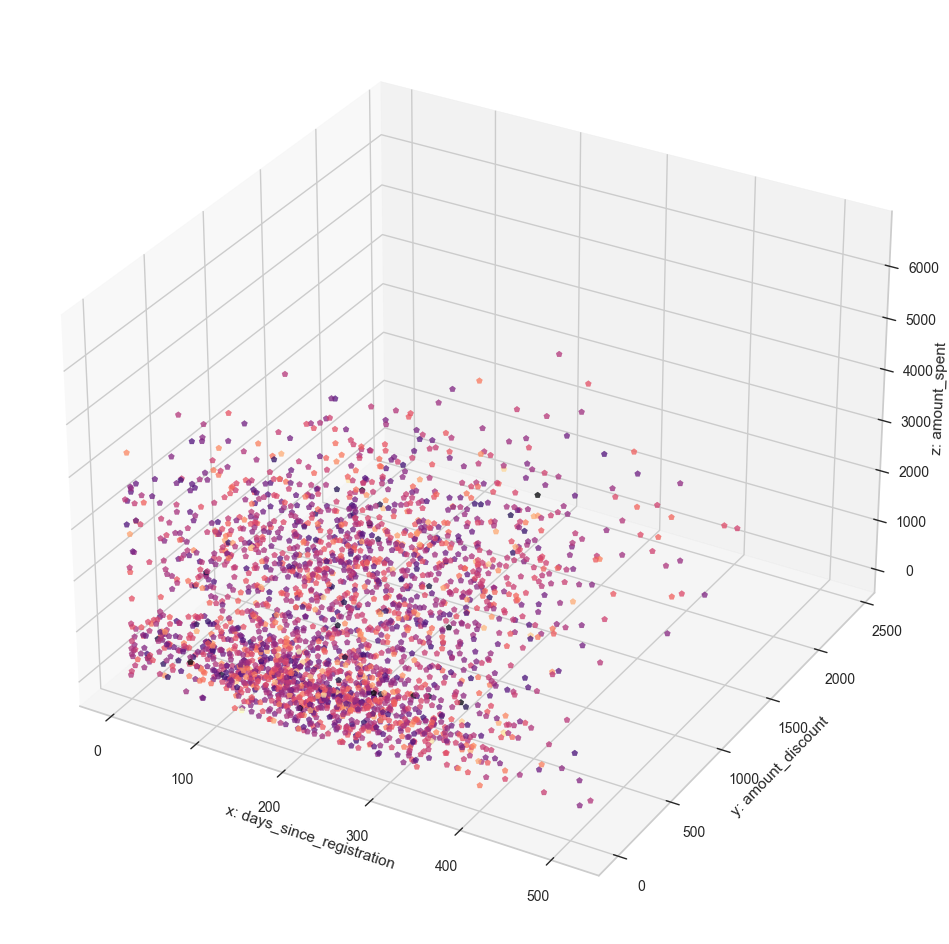

In [107]:
for permutation in permutations:
    view_clusters_3d(X, list(permutation))

#### handpicked features with more than 1 cluster
- n_clicks, n_visits, amount_discount 2
- n_clicks, amount_spent, amount_discount 2.5
- n_clicks, amount_discount, n_visits 2
- n_clicks, amount_discount, amount_spent 3 
- n_clicks, amount_discount, days_since_registration 2

- n_visits, n_clicks, amount_discount 2
- n_visits, amount_spent, amount_discount 1.5
- n_visits, amount_discount, n_clicks 2
- n_visits, amount_discount, amount_spent 3

- amount_spent, n_clicks, n_visits 1.5
- amount_spent, n_clicks, amount_discount 3
- amount_spent, n_visits, n_clicks 2
- amount_spent, n_visits, amount_discount 3
- amount_spent, amount_discount, n_clicks 3
- amount_spent, amount_discount, n_vists 3
- amount_spent, days_since_registration, n_clicks 2 
- amount_spent, days_since_registration, n_visits 2 
- amount_spent, days_since_registration, amount_discount 3

- amount_discount, n_clicks, n_visits 2
- amount discount, n_clicks, amount_spent 3
- amount discount, n_clicks, days_since_registration 2
- amount_discount, n_visits, n_clicks 2
- amount_discount, n_visits, amount_spent 3
- amount_discount, n_visits, days_since_registration 2
- amount_discount, days_since_registration, amount_spent 3

**next is to pick the the feature sets with the most relevant feawtures and with clusters more than or equal 2**

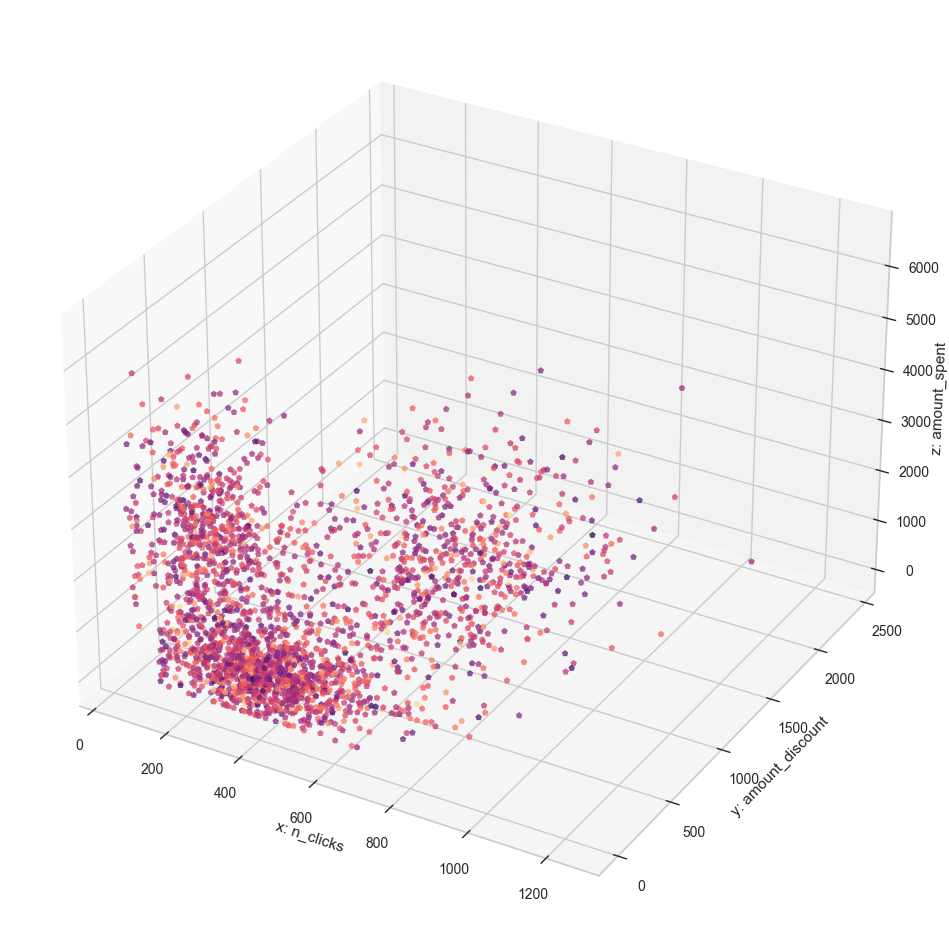

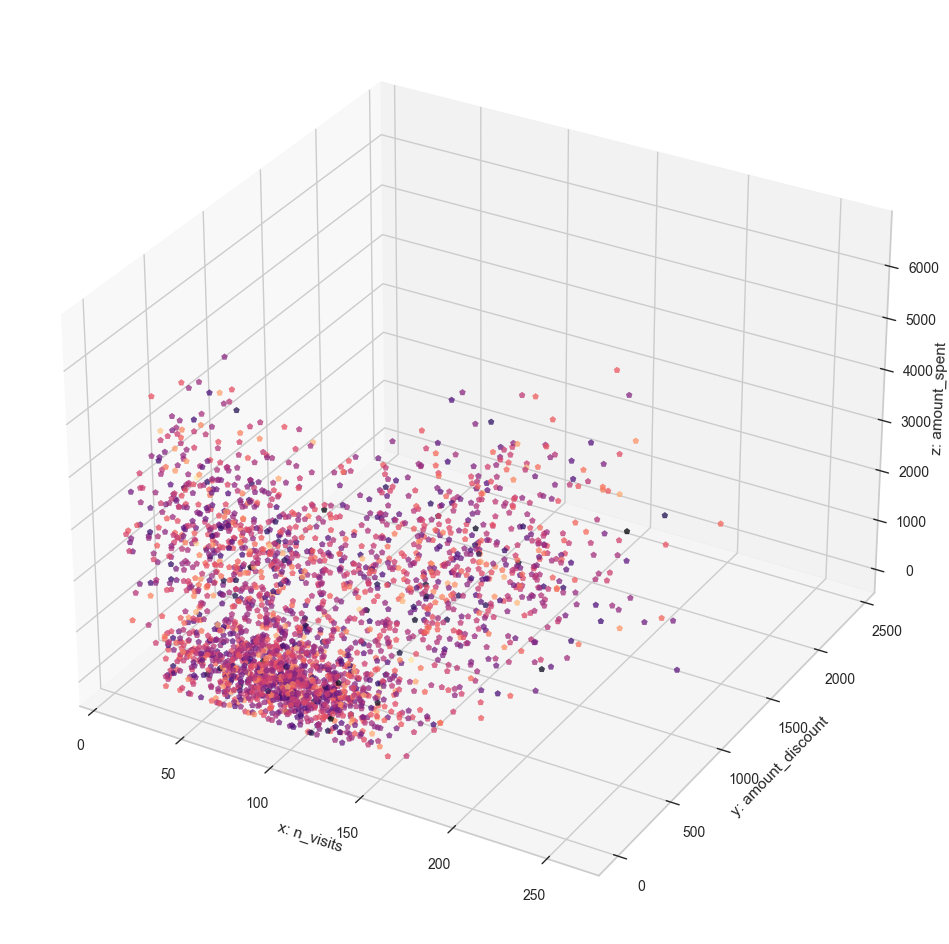

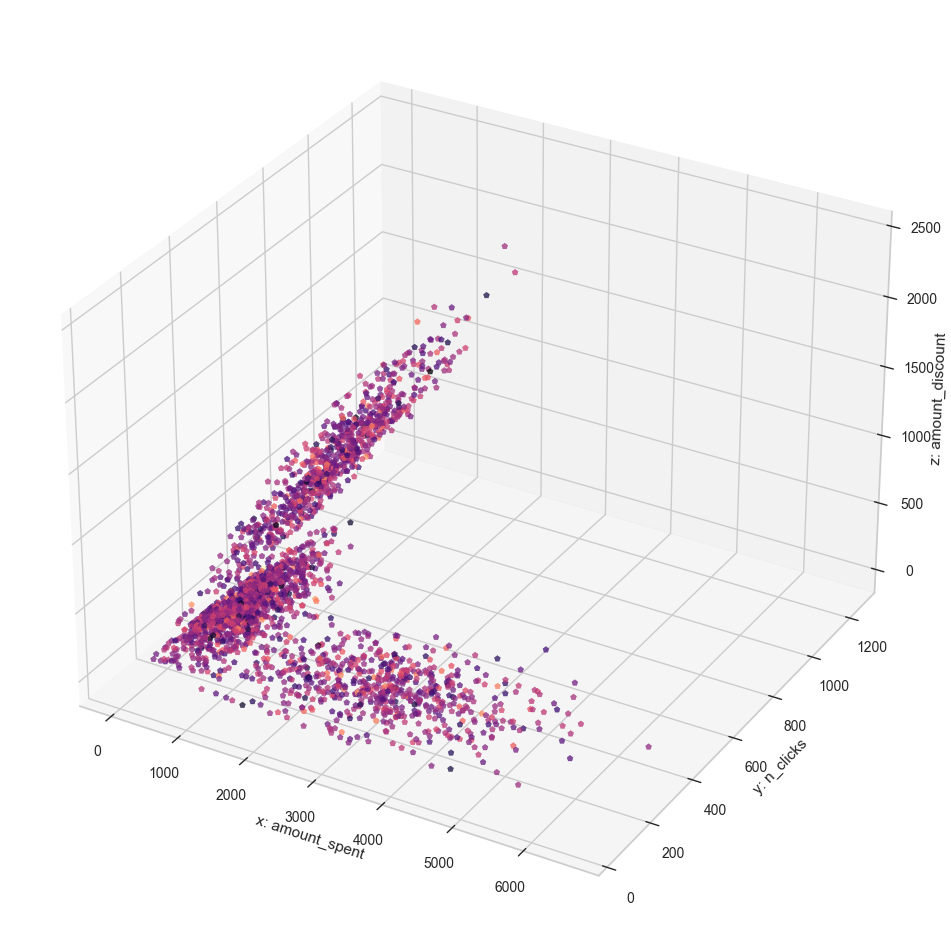

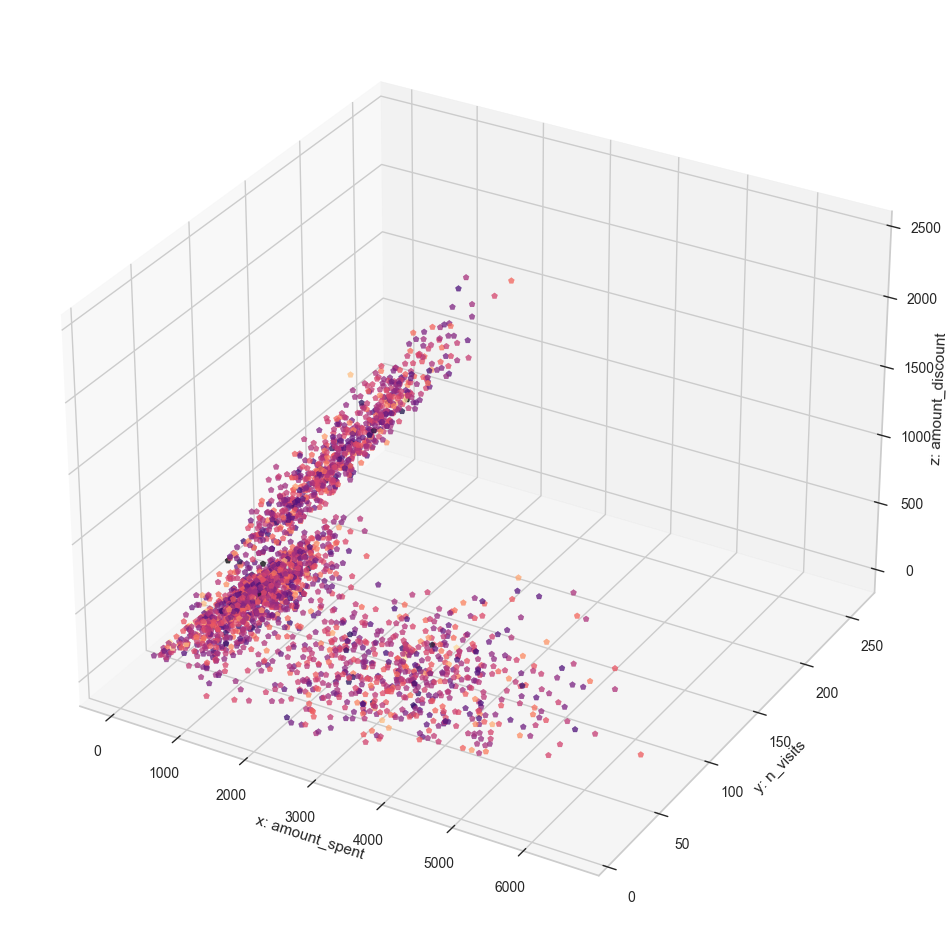

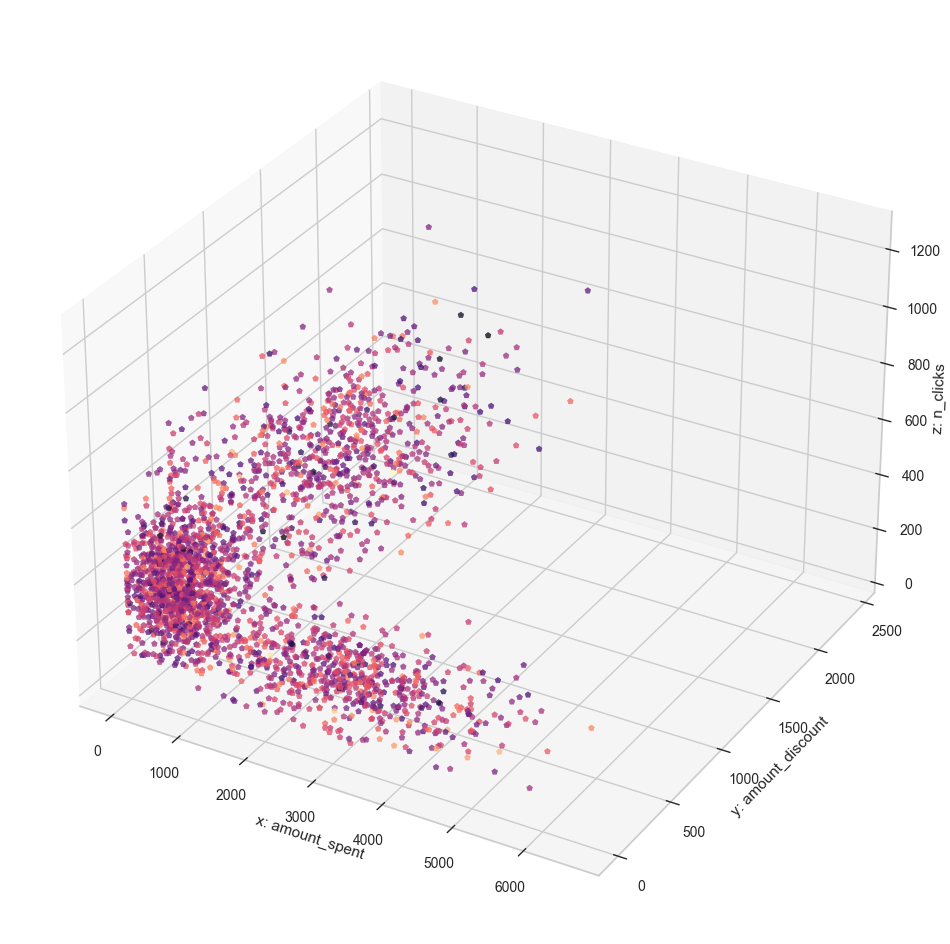

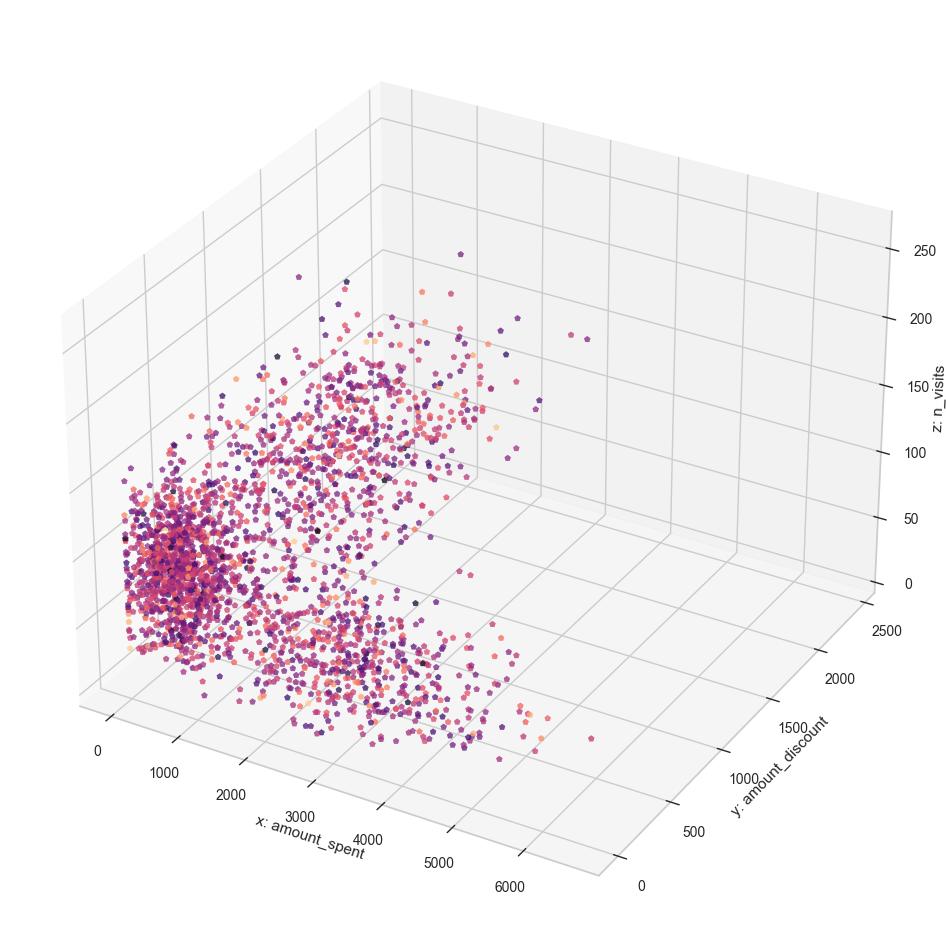

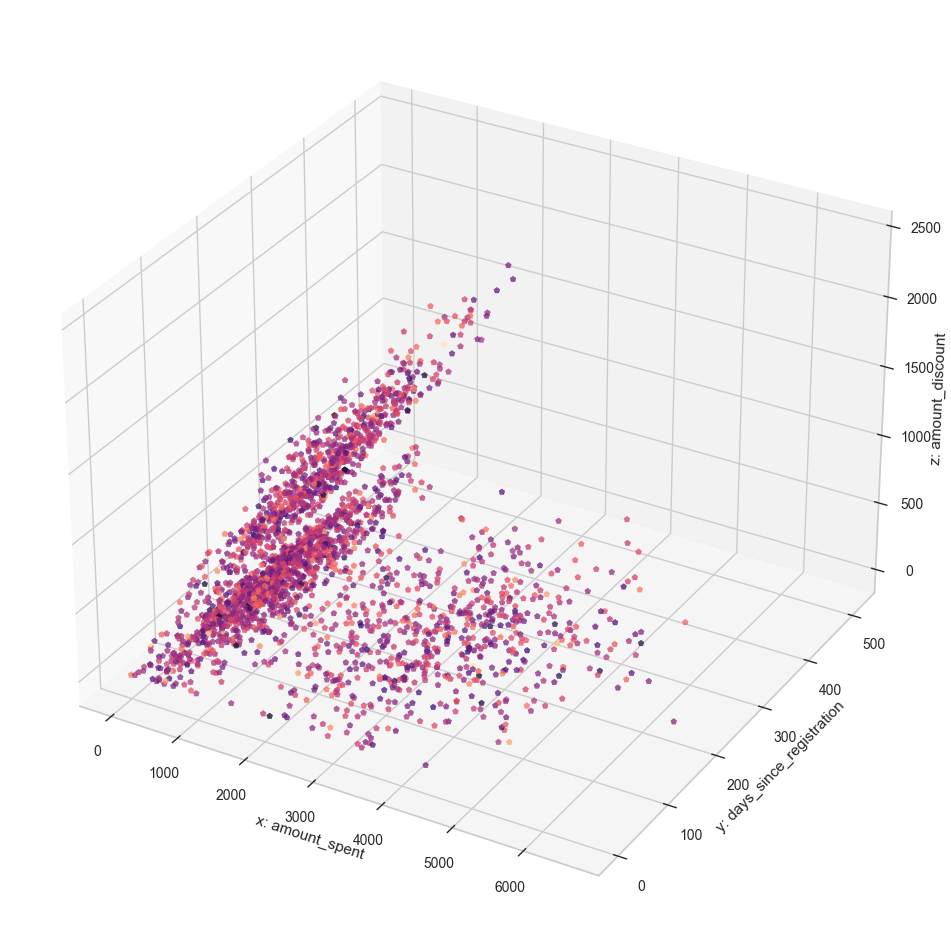

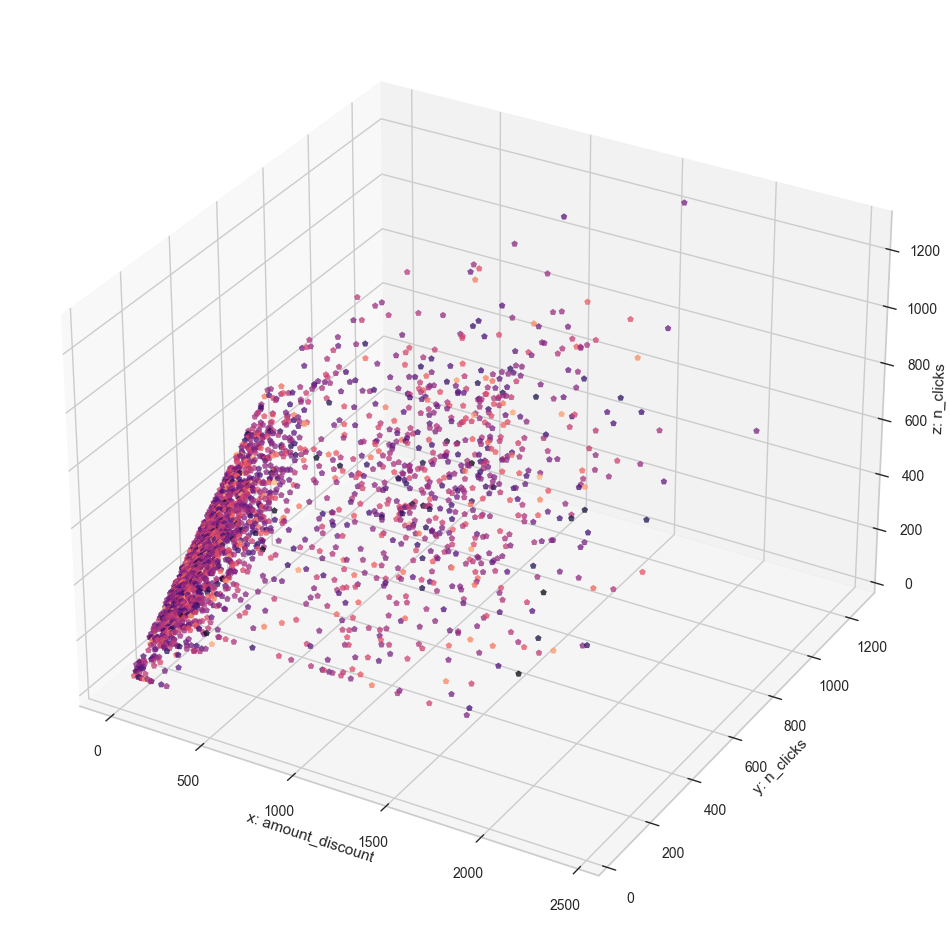

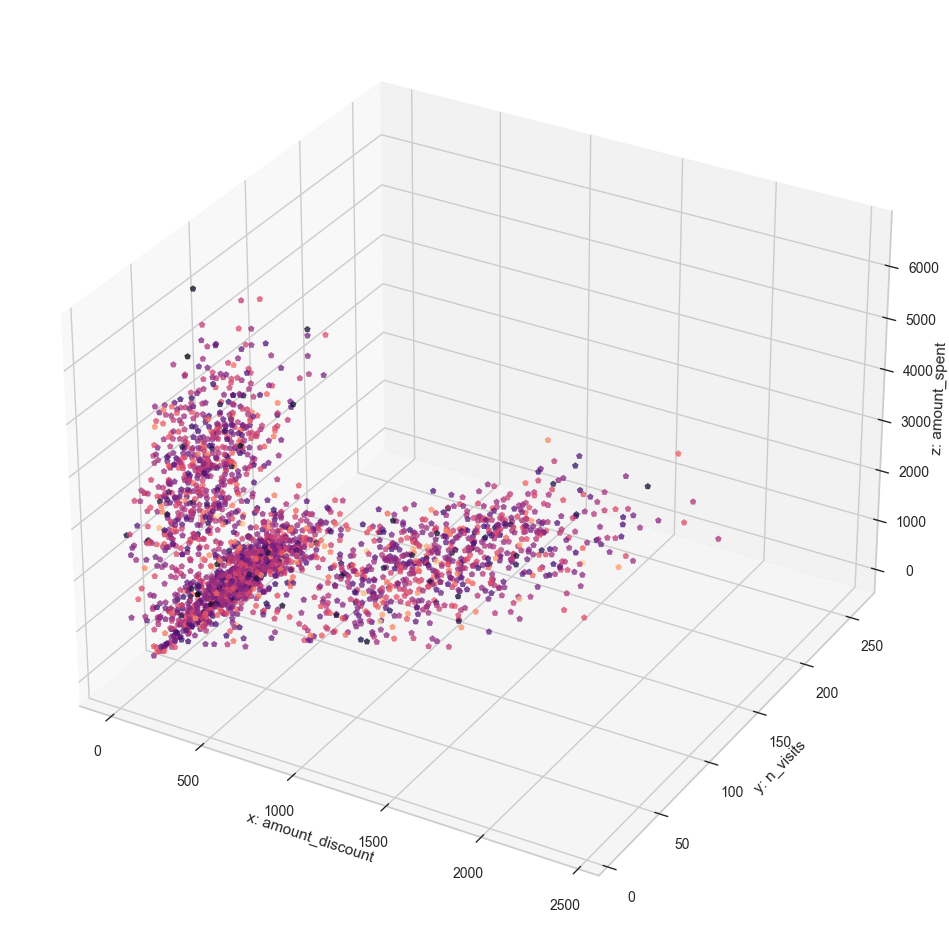

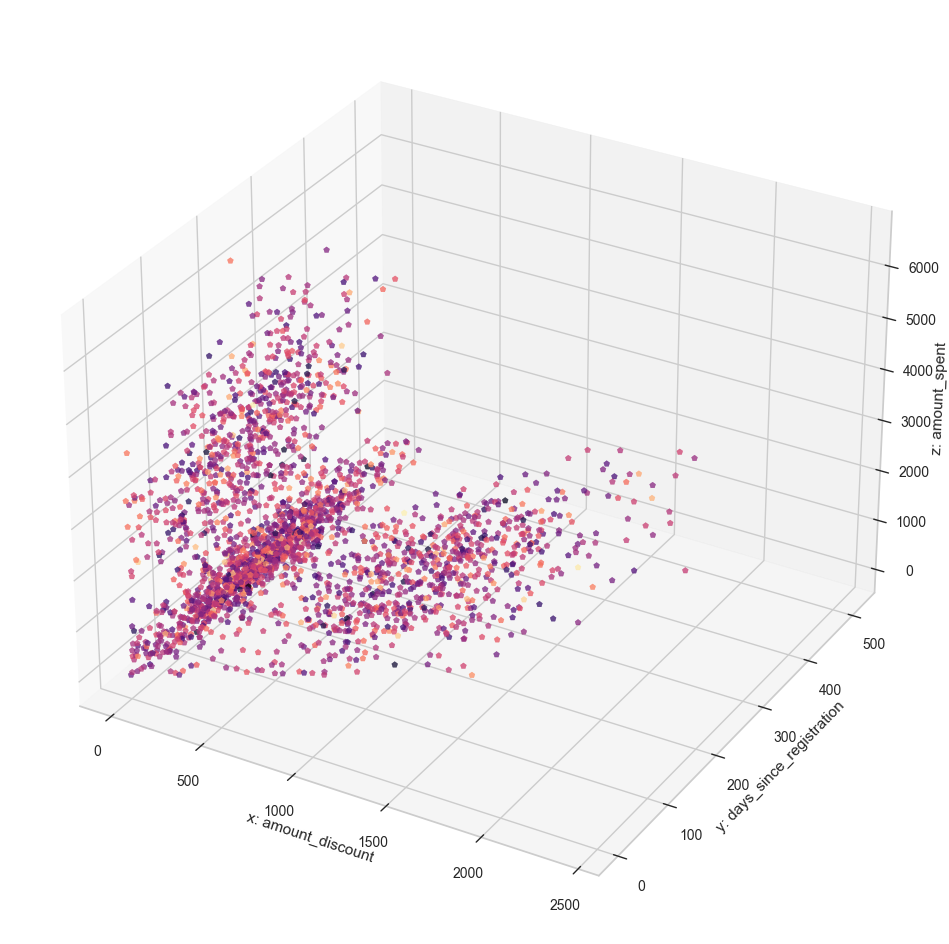

In [108]:
# re visualize datapoints with 3 or more clusters

feature_sets = [
    ['n_clicks', 'amount_discount', 'amount_spent'],
    ['n_visits', 'amount_discount', 'amount_spent'],
    ['amount_spent', 'n_clicks', 'amount_discount'],
    ['amount_spent', 'n_visits', 'amount_discount'],
    ['amount_spent', 'amount_discount', 'n_clicks'],
    ['amount_spent', 'amount_discount', 'n_visits'],
    ['amount_spent', 'days_since_registration', 'amount_discount'],
    ['amount_discount', 'n_clicks', 'n_clicks'],
    ['amount_discount', 'n_visits', 'amount_spent'],
    ['amount_discount', 'days_since_registration', 'amount_spent']
]

for feature_set in feature_sets:
    view_clusters_3d(X, feature_set)

c:\ProgramData\Anaconda3\envs\minkowski-dist-app\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\ProgramData\Anaconda3\envs\minkowski-dist-app\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\ProgramData\Anaconda3\envs\minkowski-dist-app\Lib\site-packages\yellowbrick\utils\kneed.py:156: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
c:\ProgramData\Anaconda3\envs\minkowski-dist-app\Lib\site-packages\yellowbrick\cluster\elbow.py:374: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the 

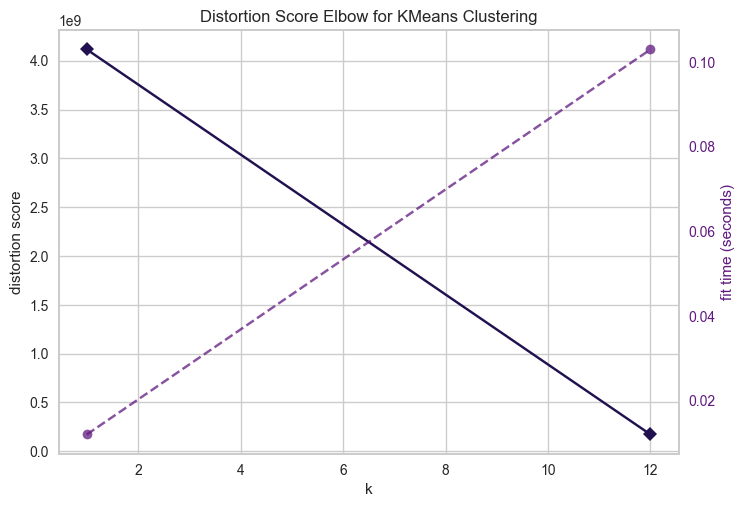

In [109]:
model = KMeans_1()
visualizer = KElbowVisualizer(model, k=[1, 12], distance_metric='euclidean')

visualizer.fit(X)
visualizer.show()
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 643.          228.43250321  300.        ]
 [ 527.           60.88283134  743.83250752]
 [ 367.           72.96180132  305.66888582]
 ...
 [ 561.          146.63741213  936.91595926]
 [ 347.          119.28416225  404.90529604]
 [ 823.         1138.21948445 1433.67721871]]
initial centroids [[ 515.           50.24578308  731.01976667]
 [ 246.           49.75511713 2431.92739172]
 [ 550.          786.72068992  904.70038943]]



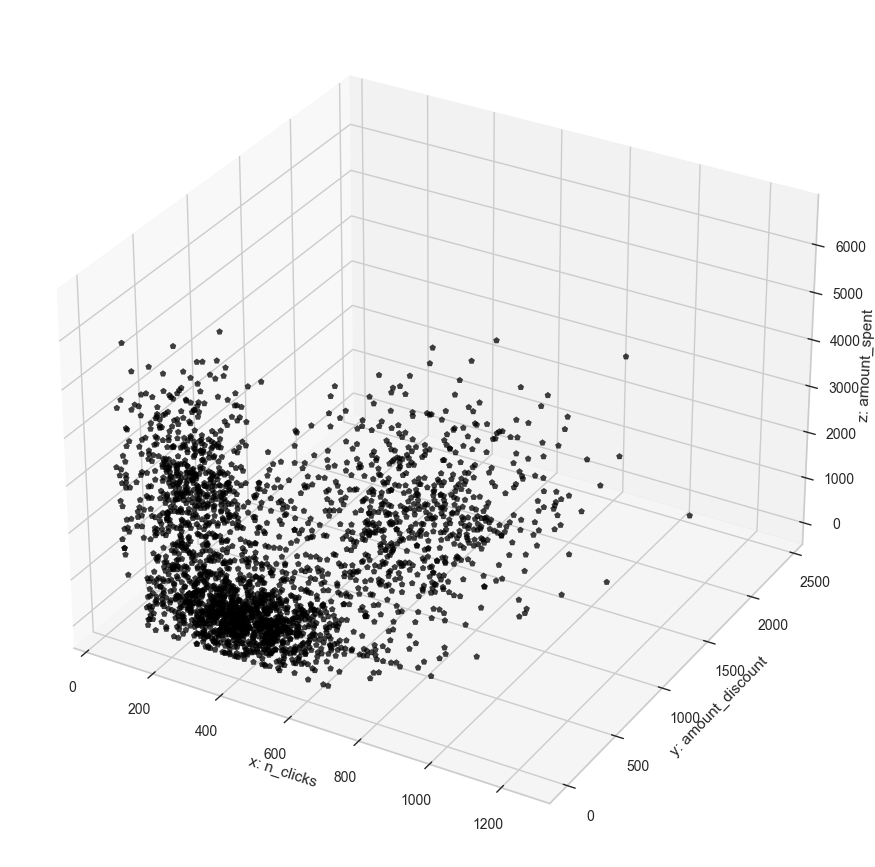

centroid at epoch 0/299: 
[[ 515.           50.24578308  731.01976667]
 [ 246.           49.75511713 2431.92739172]
 [ 550.          786.72068992  904.70038943]]

points of cluster 0: [[643.         228.43250321 300.        ]
 [527.          60.88283134 743.83250752]
 [367.          72.96180132 305.66888582]
 ...
 [414.         206.5650959  638.1128076 ]
 [561.         146.63741213 936.91595926]
 [347.         119.28416225 404.90529604]]

points of cluster 1: [[ 339.           43.9636836  3550.73229352]
 [ 169.          145.46900631 4006.94232947]
 [ 337.           57.45648623 2335.62131143]
 ...
 [ 178.           81.04646503 3341.99832216]
 [ 231.          148.31370195 3328.6281992 ]
 [ 241.            5.12945728 1985.95420556]]

points of cluster 2: [[ 715.          506.41673523  703.13687786]
 [ 600.          717.69649646 1008.16977135]
 [ 624.          723.35029124  844.54096823]
 ...
 [ 537.         1855.35659043 2217.9562001 ]
 [ 527.          693.29050793  914.89154263]
 [ 823. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


m: (301, 3)
centroids of cluster 0: [[515.          50.24578308 731.01976667]
 [390.855565   122.00712109 604.49171447]
 [397.72105672 154.67141193 629.41329114]
 [402.44015152 166.4239494  638.27193913]
 [403.90641509 170.10279263 637.58447367]
 [404.95701357 172.20467647 636.00247362]
 [404.95701357 172.20467647 636.00247362]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763]
 [404.9645283  172.10644277 635.42273763

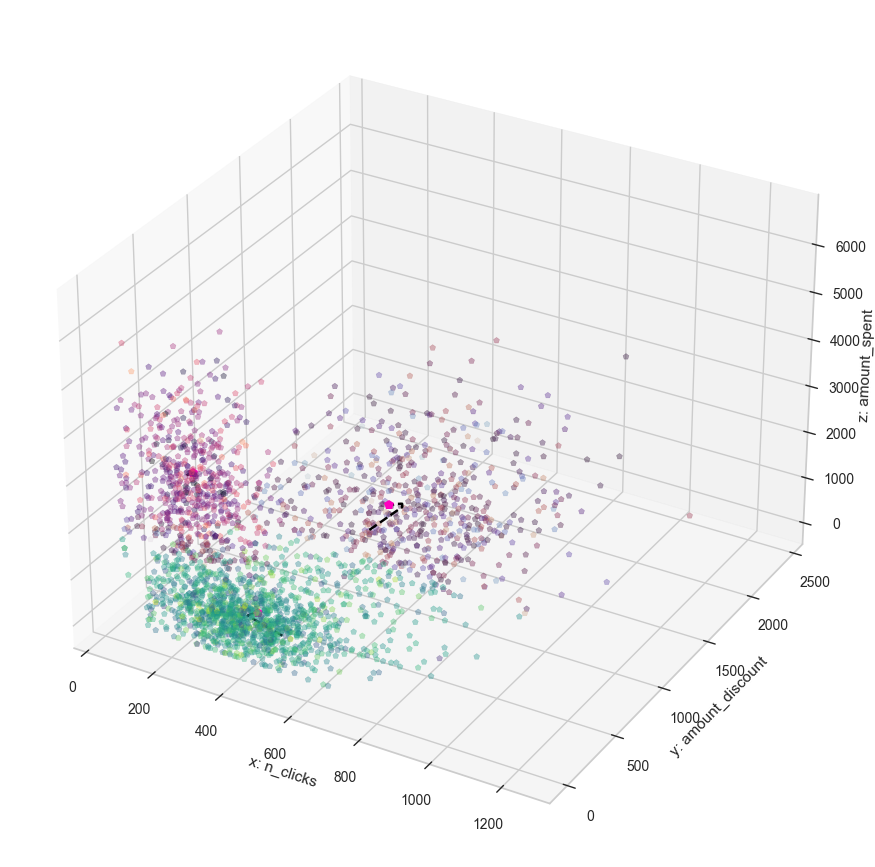

In [110]:
data = load_ecomm_data('./data/E-commerce.csv', ['n_clicks', 'amount_discount', 'amount_spent'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['n_clicks', 'amount_discount', 'amount_spent'], p=2)
model.train()

here we have 3 clusters of users of the e-commerce platform consisting of
users clicking/interacting with the app ranging from 0 to 800, amount discounts  ranging from 0 to more than 1000, and amount spent ranging from 


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 142.          228.43250321  300.        ]
 [  95.           60.88283134  743.83250752]
 [  49.           72.96180132  305.66888582]
 ...
 [  85.          146.63741213  936.91595926]
 [  61.          119.28416225  404.90529604]
 [ 160.         1138.21948445 1433.67721871]]
initial centroids [[ 119.           16.52360038  373.83254143]
 [  98.           11.41858031 1915.70134903]
 [  72.           54.3301416   153.14059399]]



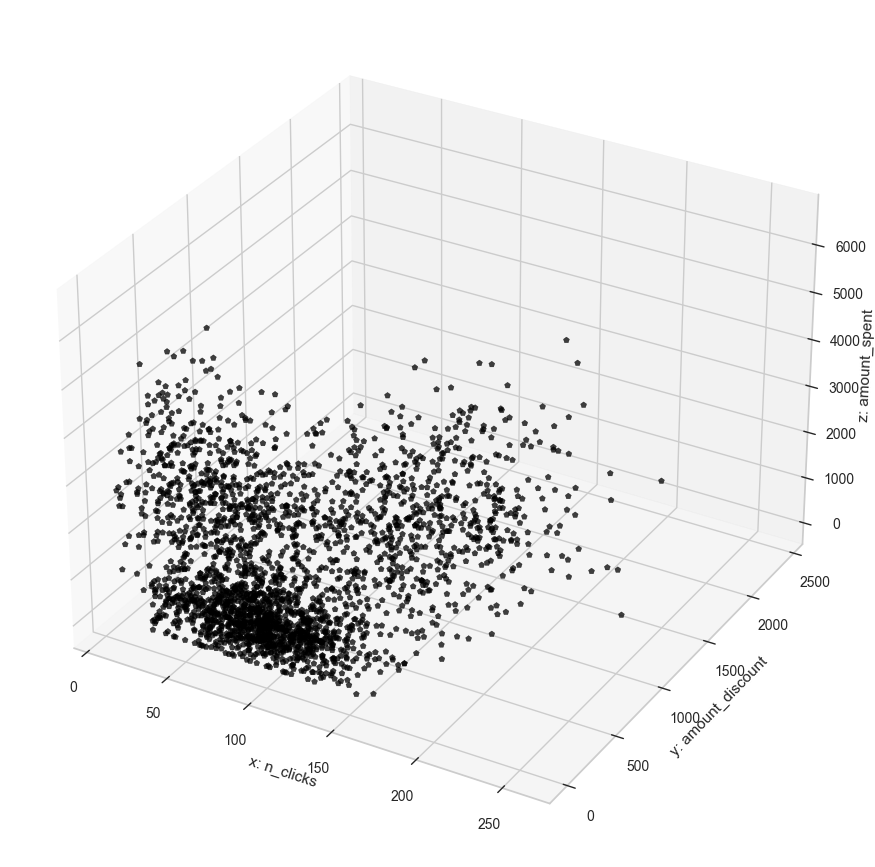

centroid at epoch 0/299: 
[[ 119.           16.52360038  373.83254143]
 [  98.           11.41858031 1915.70134903]
 [  72.           54.3301416   153.14059399]]

points of cluster 0: [[142.         228.43250321 300.        ]
 [ 95.          60.88283134 743.83250752]
 [ 49.          72.96180132 305.66888582]
 ...
 [ 99.         693.29050793 914.89154263]
 [ 85.         146.63741213 936.91595926]
 [ 61.         119.28416225 404.90529604]]

points of cluster 1: [[  85.           28.54359035 1260.69022776]
 [  87.           43.9636836  3550.73229352]
 [  54.          145.46900631 4006.94232947]
 ...
 [ 165.          148.31370195 3328.6281992 ]
 [  26.            5.12945728 1985.95420556]
 [ 160.         1138.21948445 1433.67721871]]

points of cluster 2: [[6.90000000e+01 4.33257589e+01 1.41887682e+02]
 [9.70000000e+01 6.18208499e+01 2.52729583e+02]
 [1.16000000e+02 1.09495655e+00 2.16521211e+02]
 [8.50000000e+01 5.95699063e+00 3.18019221e+01]
 [1.27000000e+02 2.04457158e+01 1.37613402e+02

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


centroid at epoch 299/299: 
[[ 114.59708029 1020.9270219  1568.21211097]
 [  69.24137931   84.37111811 3456.22412563]
 [  93.45990923  174.23723234  631.30338395]]

points of cluster 0: [[ 135.          717.69649646 1008.16977135]
 [ 114.          790.61843479 1069.99896794]
 [ 119.         1320.84559926 1732.18267319]
 ...
 [ 146.         1855.35659043 2217.9562001 ]
 [  26.            5.12945728 1985.95420556]
 [ 160.         1138.21948445 1433.67721871]]

points of cluster 1: [[  87.           43.9636836  3550.73229352]
 [  54.          145.46900631 4006.94232947]
 [ 114.           57.45648623 2335.62131143]
 ...
 [  10.           59.69034898 3480.21578457]
 [  63.           81.04646503 3341.99832216]
 [ 165.          148.31370195 3328.6281992 ]]

points of cluster 2: [[142.         228.43250321 300.        ]
 [ 95.          60.88283134 743.83250752]
 [ 49.          72.96180132 305.66888582]
 ...
 [ 99.         693.29050793 914.89154263]
 [ 85.         146.63741213 936.91595926]
 [ 

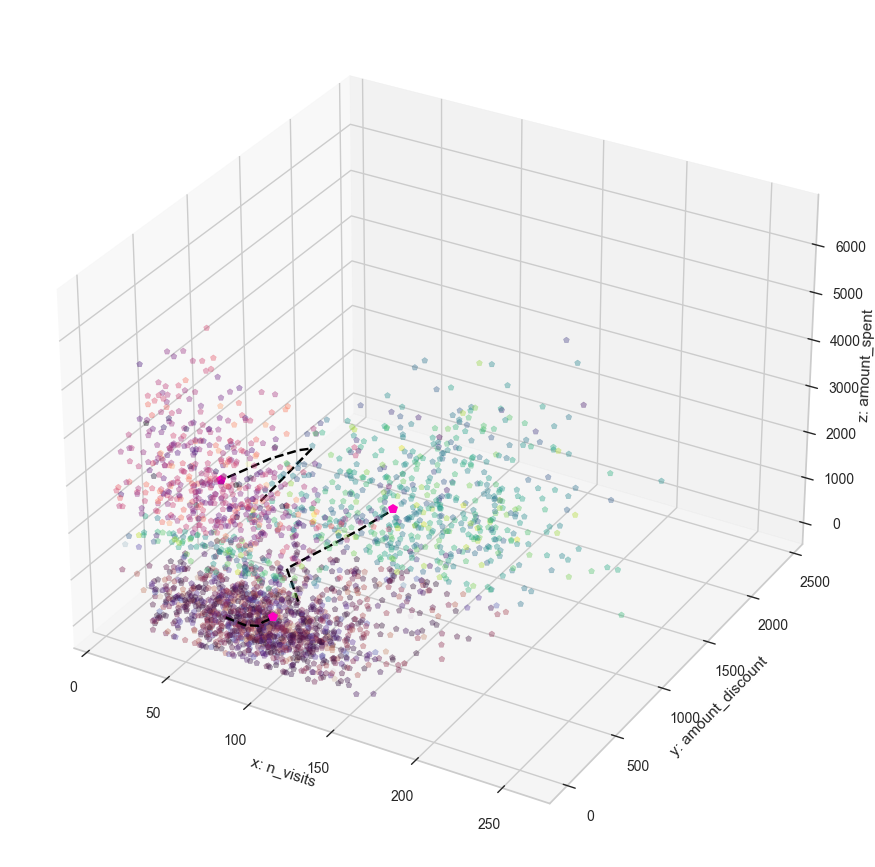

In [111]:
data = load_ecomm_data('./data/E-commerce.csv', ['n_visits', 'amount_discount', 'amount_spent'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['n_visits', 'amount_discount', 'amount_spent'], p=2)
model.train()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 300.          132.          228.43250321]
 [ 743.83250752   86.           60.88283134]
 [ 305.66888582  334.           72.96180132]
 ...
 [ 936.91595926   96.          146.63741213]
 [ 404.90529604  194.          119.28416225]
 [1433.67721871  271.         1138.21948445]]
initial centroids [[1439.00464244  232.         1016.98597308]
 [1117.95004492    2.          955.51576083]
 [1879.27172563  413.         1574.30421522]]



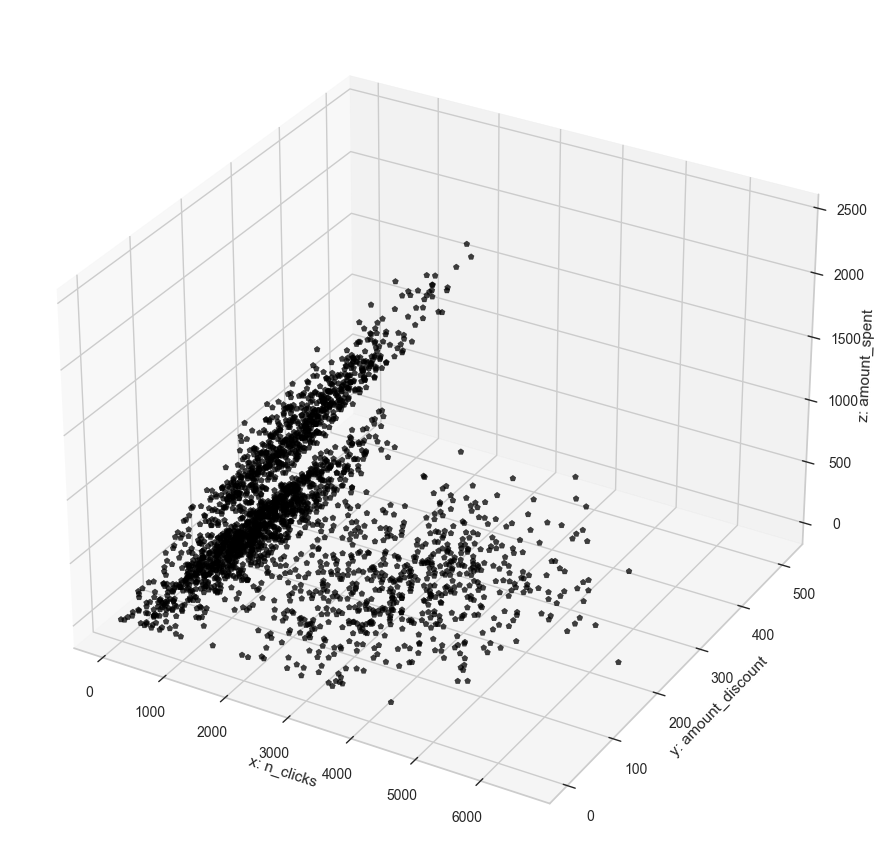

centroid at epoch 0/299: 
[[1439.00464244  232.         1016.98597308]
 [1117.95004492    2.          955.51576083]
 [1879.27172563  413.         1574.30421522]]

points of cluster 0: [[2335.62131143   36.           57.45648623]
 [1497.29946768  244.         1245.60940279]
 [1848.39791905  318.           79.88464041]
 ...
 [1513.71911404  317.         1187.63575025]
 [1985.95420556  220.            5.12945728]
 [1433.67721871  271.         1138.21948445]]

points of cluster 1: [[300.         132.         228.43250321]
 [743.83250752  86.          60.88283134]
 [305.66888582 334.          72.96180132]
 ...
 [914.89154263 135.         693.29050793]
 [936.91595926  96.         146.63741213]
 [404.90529604 194.         119.28416225]]

points of cluster 2: [[3550.73229352  200.           43.9636836 ]
 [4006.94232947  147.          145.46900631]
 [1732.18267319  376.         1320.84559926]
 ...
 [3480.21578457    0.           59.69034898]
 [3341.99832216  285.           81.04646503]
 [3328.6

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


points of cluster 0: [[1008.16977135  165.          717.69649646]
 [1069.99896794  258.          790.61843479]
 [1732.18267319  376.         1320.84559926]
 ...
 [2217.9562001    73.         1855.35659043]
 [1985.95420556  220.            5.12945728]
 [1433.67721871  271.         1138.21948445]]

points of cluster 1: [[300.         132.         228.43250321]
 [743.83250752  86.          60.88283134]
 [305.66888582 334.          72.96180132]
 ...
 [914.89154263 135.         693.29050793]
 [936.91595926  96.         146.63741213]
 [404.90529604 194.         119.28416225]]

points of cluster 2: [[3550.73229352  200.           43.9636836 ]
 [4006.94232947  147.          145.46900631]
 [2335.62131143   36.           57.45648623]
 ...
 [3480.21578457    0.           59.69034898]
 [3341.99832216  285.           81.04646503]
 [3328.6281992   157.          148.31370195]]

centroid at epoch 299/299: 
[[1568.21211097  202.10656934 1020.9270219 ]
 [ 631.30338395  201.44629349  174.23723234]
 [3456

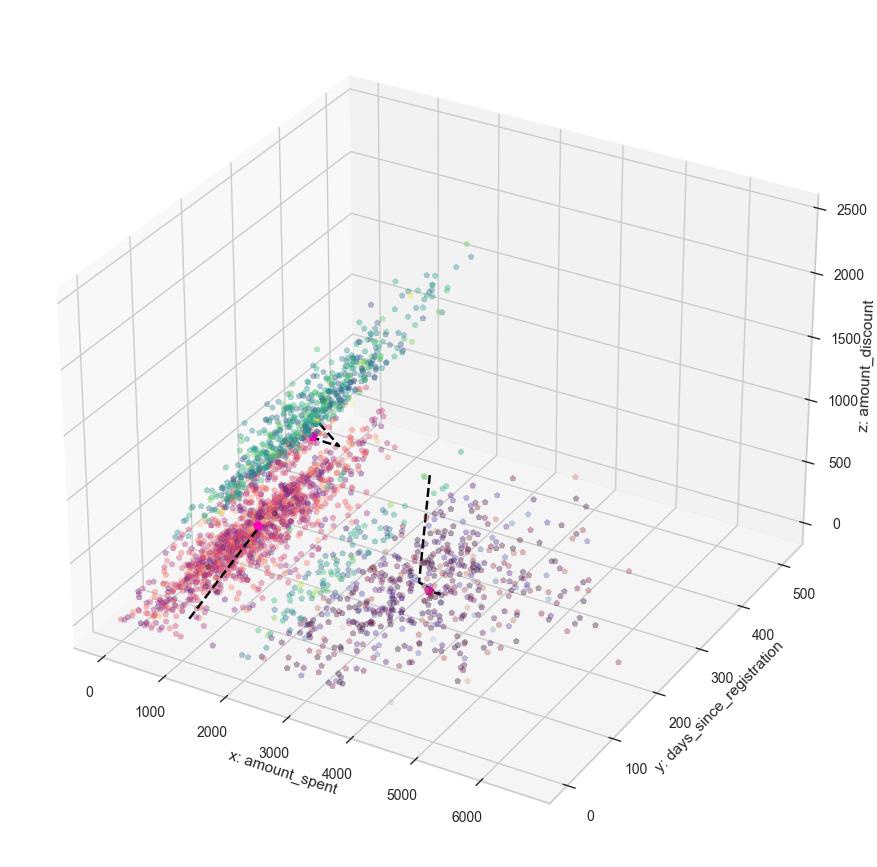

In [112]:
data = load_ecomm_data('./data/E-commerce.csv', ['amount_spent', 'days_since_registration', 'amount_discount'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['amount_spent', 'days_since_registration', 'amount_discount'], p=2)
model.train()

X: amount spent by user, Y: days since registration by user, Z: amount discount granted to user
magma cluster users:
X: 2000-5000, Y: 0-450, Z: 0-250

viridis cluster users:
X: 0-1000, Y: 0-450, Z: 0-750

twilight cluster users:
X: 1000-2500, Y: 0-450, Z: 750-2125

Conclusions: Firstly in the magma cluster these users have a relatively high amount spent (between 2000 and 5000). They are relatively new to the platform (within 0-450 days since registration) and receive moderate discounts (0-250). These users may be early adopters or high-value customers who are willing to spend more. In the viridis cluster these users have a lower amount spent (between 0 and 1000), similar registration duration (0-450 days), but can receive higher discounts (0-750). They might be price-sensitive customers who are attracted to larger discounts and lower-priced products. Lastly the in the twilight cluster these users have moderate amounts spent (between 1000 and 2500), similar registration duration (0-450 days), and relatively higher discounts (750-2125). They might be customers who respond well to specific discount offers and are willing to make moderate purchases.



X: number of clicks by user in platform, Y: amount discount granted to user, Z: amount spent by user
magma cluster users:
X: 125-800, Y: 0-750, Z: 0-1500

viridis cluster users:
X: 200-900, Y: 0-2000, Z: 1500-2000

twilight cluster users:
X: 0-600, Y: 0-250, Z: 2400-6000

Conclusions: Firstly in the magma cluster these users have a moderate number of clicks (125-800), moderate discounts received (0-750), and moderate amounts spent (0-1500). They are engaged with the platform, take advantage of discounts, and make reasonable purchases. In the viridis cluster these users have a higher number of clicks (200-900), wider range of discounts (0-2000), and higher amounts spent (1500-2000). They might be highly engaged customers who explore the platform extensively, are attracted by discounts, and make significant purchases. In the twilight cluster these users have a lower number of clicks (0-600), receive moderate discounts (0-250), but have higher amounts spent (2400-6000). They might be less active in browsing or exploring but are more focused on specific products or categories, leading to higher spending.



X: number of visits by user on platform, Y: amount discount granted to user, Z: amount spent by user
magma cluster users:
X: 0-125 , Y: 0-250, Z: 2500-2600

viridis cluster users:
X: 45-200, Y: 0-2000, Z: 1000-2500

twilight cluster users:
X: 45-200 , Y: 0-750, Z: 0-1500

Conclusions: Firstly in the magma cluster these users have a relatively low number of visits (0-125), receive moderate discounts (0-250), and have a narrow range of amounts spent (2500-2600). They might be infrequent visitors who have specific preferences or requirements, resulting in fewer visits but higher spending. In the viridis cluster these users have a moderate number of visits (45-200), wider range of discounts (0-2000), and a moderate range of amounts spent (1000-2500). They engage with the platform regularly, are attracted to discounts, and make moderate purchases. In the twilight cluster these users have a moderate number of visits (45-200), receive moderate discounts (0-750), and have a moderate range of amounts spent (0-1500). They exhibit similar behavior to the Viridis Cluster users but with lower spending tendencies.

